# Import Modules

In [1]:
import json
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import statistics as stats
import geopandas as gpd
from shapely.geometry import Point
import folium
import branca.colormap as cm
import numpy as np

# Variables

In [2]:
# text file name 
# SENTINEL Paths
SENTINEL_PATH_ORIGINAL = "data/modelling/baseline_datasets/20250609_sentinel_bands_30_days.txt"
SENTINEL_PATH_EXTRA = "data/modelling/baseline_datasets/20250630_sentinel_bands.txt"
SENTINEL_PATH_DAYOF = "data/modelling/baseline_datasets/250630_sentinel_dayof_survey_bands.txt"

# Sentinel Clouds Paths
SENTINEL_CLOUDS_ORIGINAL = "data/modelling/baseline_datasets/20250612_cloudprob_only_array_30_days.txt"
SENTINEL_CLOUDS_EXTRA = "data/modelling/baseline_datasets/20250704_cloudprob_only_array_extra.txt"
SENTINEL_CLOUDS_DAYOF = "data/modelling/baseline_datasets/20250701_cloudprob_only_array_dayof.txt"

SOIL_PATH = "data/modelling/baseline_datasets/250627_lucas_2018_cleaned.csv"

# Load the Raw Data Files

In [3]:
# Function to read text files as json
def read_txt_as_df(filepath):
    rows = []
    with open(filepath, 'r+') as f:
        for line in f:
            try: 
                data = json.loads(line)
                if isinstance(data, dict):
                    rows.append(data)
            except json.JSONDecodeError:
                continue

    # Convert to a dataframe
    df = pd.DataFrame(rows)
    return df

## Load Data

In [4]:
# Sentinel Surface Reflectance
sentinel_older = read_txt_as_df(SENTINEL_PATH_ORIGINAL)
sentinel_extra = read_txt_as_df(SENTINEL_PATH_EXTRA)
sentinel_dayof = read_txt_as_df(SENTINEL_PATH_DAYOF)

# Sentinel Cloud Cover
sencloud_older = read_txt_as_df(SENTINEL_CLOUDS_ORIGINAL)
sencloud_extra = read_txt_as_df(SENTINEL_CLOUDS_EXTRA)
sencloud_dayof = read_txt_as_df(SENTINEL_CLOUDS_DAYOF)

# Read Soil
soil = pd.read_csv(SOIL_PATH)

## Merge the Dataframes

### Sentinel Surface Reflection

In [5]:
# Columns to join on
cols = ['point_id', 'survey_date', 'image_date', 'days_diff']

In [6]:
# Concatenate all sentinel Dataframes
sentinel_all = pd.concat([sentinel_older, sentinel_extra, sentinel_dayof])

# Correct datetime format
sentinel_all['survey_date'] = pd.to_datetime(sentinel_all['survey_date'])
sentinel_all['image_date'] = pd.to_datetime(sentinel_all['image_date'])

# Calculate days between survey and image date
sentinel_all['days_diff'] = (sentinel_all['survey_date'] - sentinel_all['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_all)}")

# Drop images taken on the same date for each point ID
sentinel_all = sentinel_all.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_all)}")

Length of joined dataframe: 214520
Length of de-duplicated dataframe: 176936


### Cloud Probability

In [7]:
# Concatenate all sentinel Dataframes
sentinel_cloud = pd.concat([sencloud_older, sencloud_extra, sencloud_dayof])

# Correct datetime format
sentinel_cloud['survey_date'] = pd.to_datetime(sentinel_cloud['survey_date'])
sentinel_cloud['image_date'] = pd.to_datetime(sentinel_cloud['image_date'])

# Calculate days between survey and image date
sentinel_cloud['days_diff'] = (sentinel_cloud['survey_date'] - sentinel_cloud['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_cloud)}")

# Drop images taken on the same date for each point ID
sentinel_cloud = sentinel_cloud.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_cloud)}")

Length of joined dataframe: 175259
Length of de-duplicated dataframe: 164385


### Join Surface Reflectance and Cloud Probability

In [8]:
# Join based on point ID and Survey Date
sentinel_merged = sentinel_all.merge(sentinel_cloud, on=cols, how='inner')
print(f"Length of the joined dataframe: {len(sentinel_merged)}")
print(f"Number of Point IDs in the merged dataframe: {sentinel_merged['point_id'].nunique()}")

Length of the joined dataframe: 161933
Number of Point IDs in the merged dataframe: 15877


In [9]:
# Rename cloud probability bands so they work in the next loop
rename_dict = {'cloud_probability': 'cloud_center',
               'cloud_patch_array': 'cloud_array'}
sentinel_merged = sentinel_merged.rename(columns=rename_dict)

# Read Data from 365 Days

In [10]:
# 30-62 day dataframe
FILENAME_30_62 = "data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-62days.txt"

# CSV file for 30-365 days
FILENAME_CSV_30_365 = "data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-365days_62-365mix.csv"

# Remaining samples txt files first and second half 
FILENAME_62_365_FIRST = "data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_firsthalf.txt"
FILENAME_62_365_SECOND = "data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_secondhalf.txt"

In [ ]:
df_3062 = read_txt_as_df(FILENAME_30_62)
df_30365 = pd.read_csv(FILENAME_CSV_30_365)
df_62365_1 = read_txt_as_df(FILENAME_62_365_FIRST)
df_62365_2 = read_txt_as_df(FILENAME_62_365_SECOND)

AttributeError: 'DataFrame' object has no attribute 'tocsv'

In [20]:
# Save txt files to csvs for quicker loading next time
df_3062.to_csv("data/modelling/365day_datasets/raw/20250730_sentinel_bands_and_cloud_30-62days.csv", index=False)
df_62365_1.to_csv("data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_firsthalf.csv", index=False)
df_62365_2.to_csv("data/modelling/365day_datasets/raw/20250801_sentinel_bands_and_cloud_62-365days_secondhalf.csv", index=False)

### Merge Dataframes

In [28]:
# Concatenate all sentinel Dataframes
sentinel_365 = pd.concat([df_3062, df_30365, df_62365_1, df_62365_2])

# Correct datetime format
sentinel_365['survey_date'] = pd.to_datetime(sentinel_365['survey_date'])
sentinel_365['image_date'] = pd.to_datetime(sentinel_365['image_date'])

# Calculate days between survey and image date
sentinel_365['days_diff'] = (sentinel_365['survey_date'] - sentinel_365['image_date']).dt.days

print(f"Length of joined dataframe: {len(sentinel_365)}")

# Drop images taken on the same date for each point ID
sentinel_365 = sentinel_365.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sentinel_365)}")

Length of joined dataframe: 1406312
Length of de-duplicated dataframe: 1269099


In [29]:
# Rename cloud probability bands so they work in the next loop
rename_dict = {'cloud_probability': 'cloud_center',
               'cloud_patch_array': 'cloud_array'}
sentinel_365 = sentinel_365.rename(columns=rename_dict)

In [32]:
sentinel_365 = sentinel_365.drop(columns=['image_id'])

## Concatenate all

In [35]:
sen = pd.concat([sentinel_365, sentinel_merged])

print(f"Length of joined dataframe: {len(sen)}")

# Drop images taken on the same date for each point ID
sen = sen.drop_duplicates(subset=['point_id', 'image_date'], keep='last')
print(f"Length of de-duplicated dataframe: {len(sen)}")

Length of joined dataframe: 1431032
Length of de-duplicated dataframe: 1404272


## Save to CSV file

In [ ]:
print(f"Length of dataframe: {len(sen)}")
sen = sen.dropna()

In [36]:
sen.to_csv("data/modelling/365day_datasets/processed/20250803_sentinel2_365days_array.csv", index=False)

In [12]:
df = pd.read_csv("data/modelling/365day_datasets/processed/20250803_sentinel2_365days_array.csv")

In [13]:
sen = df.copy()

# Process Bands: Calculate mean of array

In [14]:
import ast

In [15]:
# List of bands
bands = ['AOT', 'B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 'WVP', 'cloud']

# Compute the mean for each array column
for band in bands:
    array_col = f"{band}_array"
    mean_col = f"{band}_mean"

    # def calc_mean(array):
    #     if isinstance(array, list) and all(isinstance(row, list) for row in array):
    #         flat = [val for row in array for val in row if val is not None]
    #         return np.mean(flat) if flat else None
    #     return None


    def calc_mean(array_str):
        try:
            # Convert string to actual list
            array = ast.literal_eval(array_str)
            
            # Flatten and remove None/NaN
            flat = [val for row in array for val in row if val is not None and not np.isnan(val)]
            return np.mean(flat) if flat else None
        except (ValueError, SyntaxError, TypeError):
            return None
    
    sen[mean_col] = sen[array_col].apply(calc_mean)
    sen[f"{band}_diff"] = sen[mean_col] - sen[f"{band}_center"]

In [16]:
sen = sen.dropna()

In [17]:
df = sen.copy()

In [19]:
## Save as CSV
checkpoint1 = df.copy()
SENTINEL_CSV_PROCESSED = "data/modelling/365day_datasets/processed/20250803_sentinel2_365days_mean.csv"
# Save sentinel as CSV
df.to_csv(SENTINEL_CSV_PROCESSED, index=False)

## Evaluate the Difference Between Array Mean and Centre Values

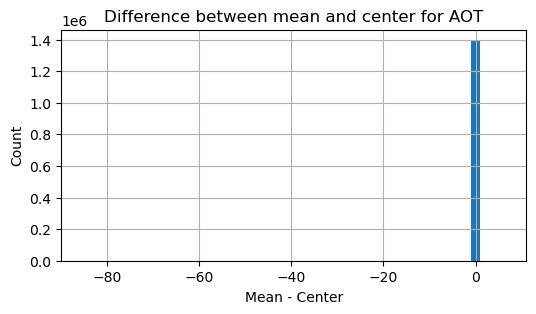

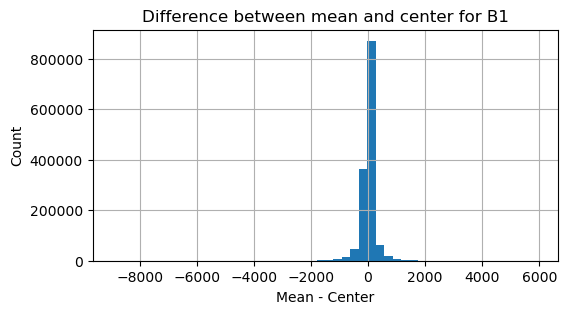

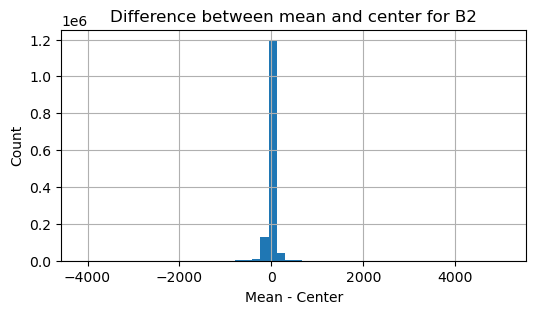

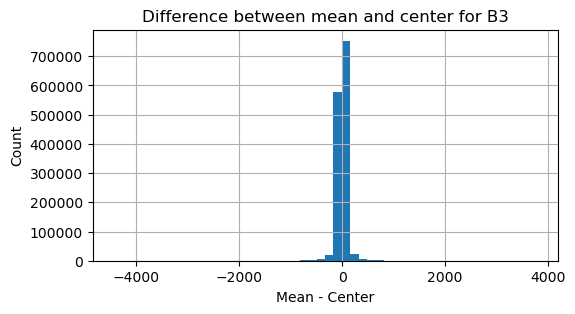

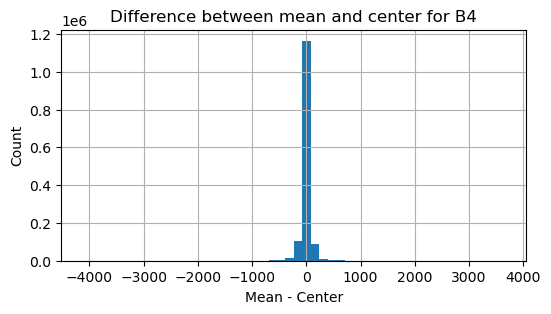

...

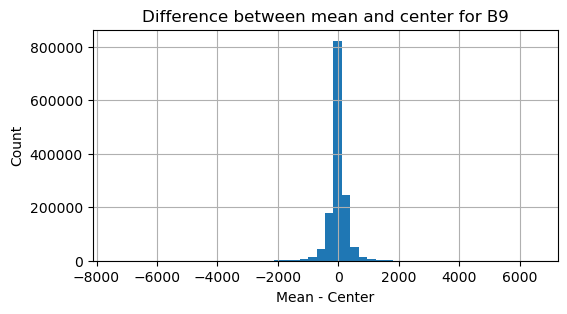

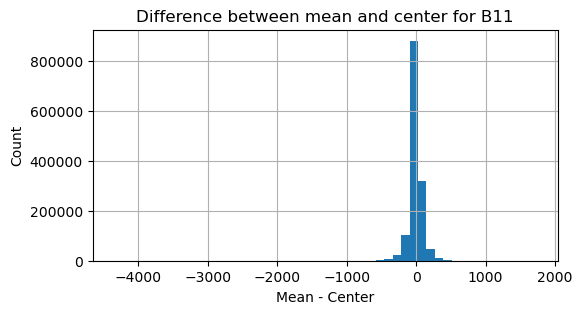

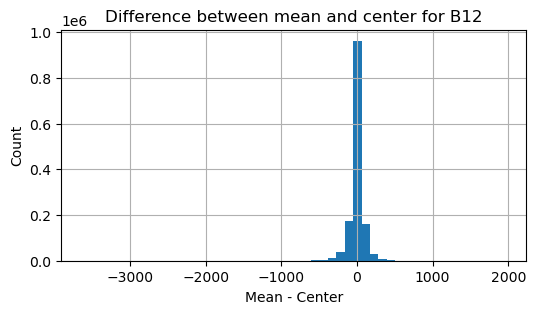

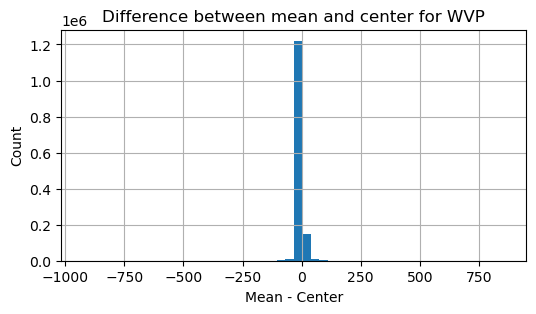

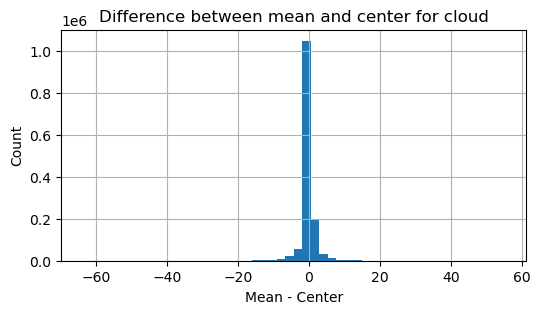

In [18]:
# Plot the difference between mean and center
for band in bands:
    df[f"{band}_diff"].hist(bins=50, figsize=(6,3))
    plt.title(f"Difference between mean and center for {band}")
    plt.xlabel("Mean - Center")
    plt.ylabel("Count")
    plt.show()

## Number of Images per Point ID

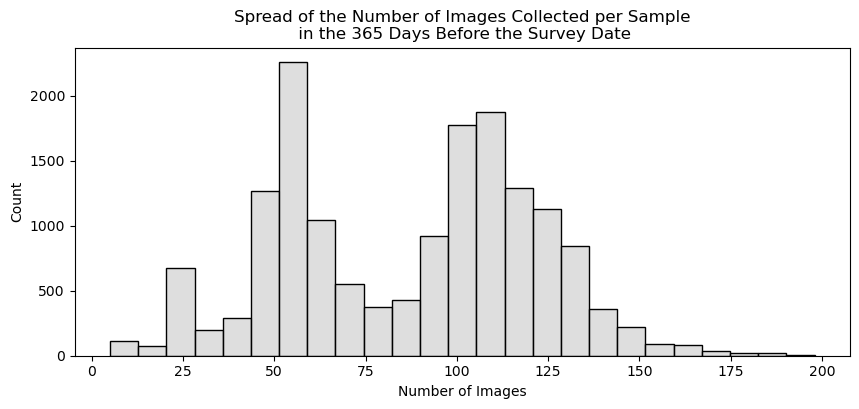

In [19]:
# Find out how many images there are for each point ID
summary = df.groupby(['point_id']).agg(
                total_images=('image_date', 'count'),
                null_count_probs=('cloud_center', lambda x: x.isnull().sum()),
                null_scl=('SCL_center', lambda x: x.isnull().sum())
            ).reset_index()

plt.figure(figsize=(10,4))
sns.histplot(summary['total_images'], bins=25, color='lightgrey')
plt.xlabel("Number of Images")
plt.title("Spread of the Number of Images Collected per Sample\n in the 365 Days Before the Survey Date")
plt.savefig('./graphs/sentinel/number_of_images_per_sample.png', dpi=300)
plt.show()

In [22]:
len(df)

1394102

Number of cloud free sentinel images: 3875
Total number of images: 1394102
Number of points with cloud free images: 2049


<Axes: xlabel='cloud_mean', ylabel='Count'>

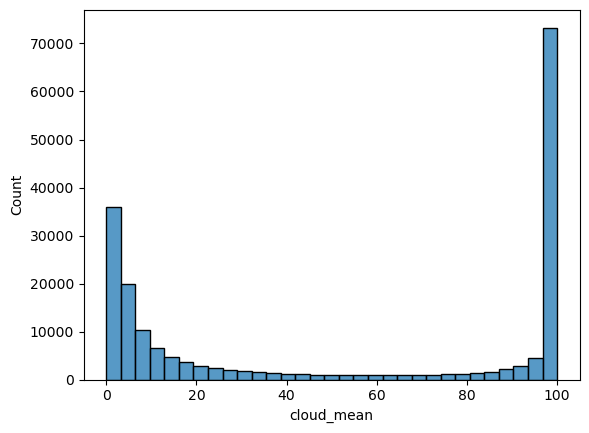

In [26]:
# Points with no cloud
print(f"Number of cloud free sentinel images: {len(df[df['cloud_mean'] == 0])}")
print(f"Total number of images: {len(df)}")
print(f"Number of points with cloud free images: {df[df['cloud_mean'] == 0]['point_id'].nunique()}")

# Within the last 30 days
last30 = df[df['days_diff'] <= 31]
sns.histplot(last30['cloud_mean'])

In [21]:
len(df)

1394102

In [23]:
# Find out why some have over 4 images
summary[summary['total_images']>150].sort_values(by='total_images', ascending=False).head()

,point_id,total_images,null_count_probs,null_scl
8172,44963922,198,0,0
13883,52263990,192,0,0
11120,48445012,190,0,0
13849,52223990,190,0,0
9211,46223850,188,0,0


In [24]:
# Preview one of the Points with 8 images
df[df['point_id']==48585066].image_date.nunique()

174

In [25]:
# Drop duplicates based on point id, survey date and image_date
df = df.drop_duplicates(subset=['point_id', 'survey_date', 'image_date'])

## Null Analysis

## Points where images could not be found

In [26]:
null_point_df = df[df['image_date'].isnull()]
print(f"Number of points without images: {null_point_df['point_id'].nunique()}")

Number of points without images: 0


## Mean, Centre and Array Values

In [30]:
# Summary of mean vs. the center value
summary = []
for band in bands:
    corr = df[[f"{band}_center", f"{band}_mean"]].corr().iloc[0,1]
    std_center = df[f"{band}_center"].std()
    std_mean = df[f"{band}_mean"].std()
    summary.append({
        'band': band,
        'correlation': corr,
        'std_center': std_center,
        'std_mean': std_mean
    })

summary_df = pd.DataFrame(summary)

In [31]:
summary_df['pct_diff'] = (1-(summary_df['std_center'] / summary_df['std_mean'])) * 100
summary_df

,band,correlation,std_center,std_mean,pct_diff
0,AOT,0.999980,61.399306,61.398656,-0.001059
1,B1,0.998231,4192.323424,4164.000645,-0.680182
2,B2,0.999634,3880.018632,3873.955211,-0.156518
3,B3,0.999598,3536.138657,3530.070678,-0.171894
4,B4,0.999568,3438.627072,3432.064814,-0.191204
5,B5,0.998966,3387.447546,3373.815568,-0.404052
6,B6,0.998524,2957.132138,2942.026277,-0.513451
7,B7,0.998258,2806.804476,2790.435375,-0.586615
8,B8,0.999120,2840.308912,2831.198604,-0.321783
9,B8A,0.998157,2671.680364,2655.075016,-0.625419


## Difference between Mean and Centre

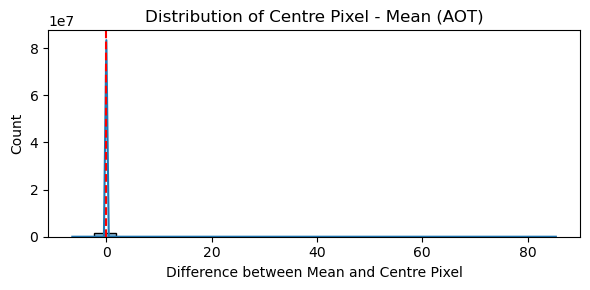

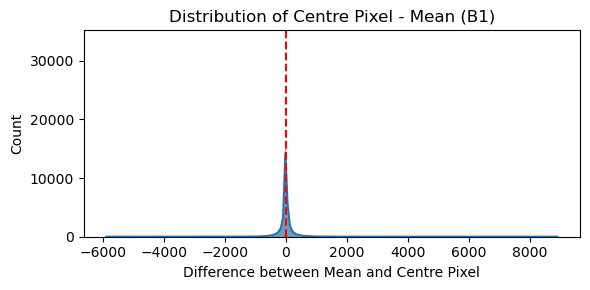

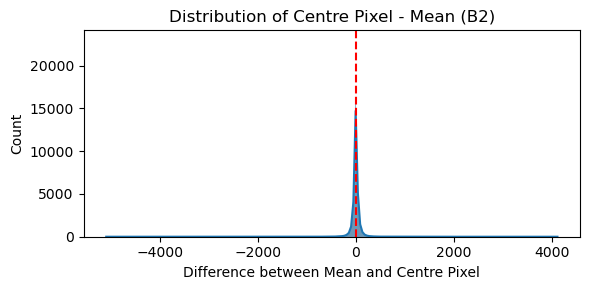

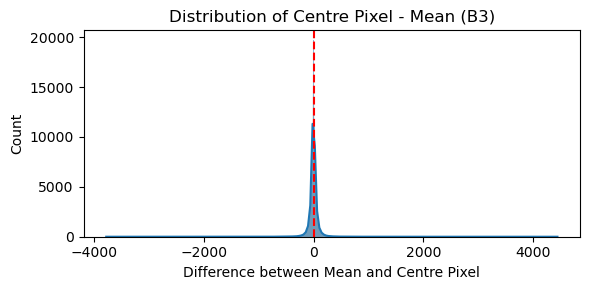

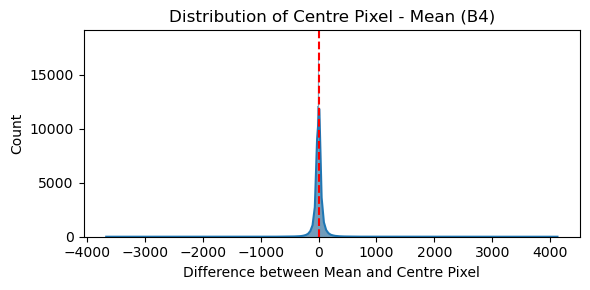

...

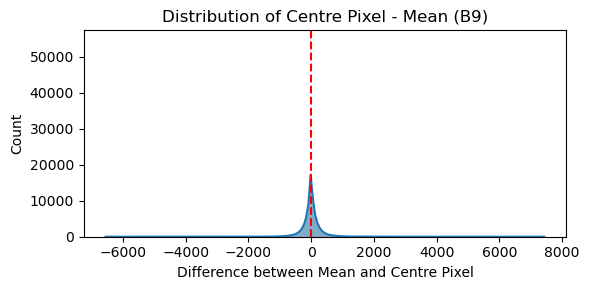

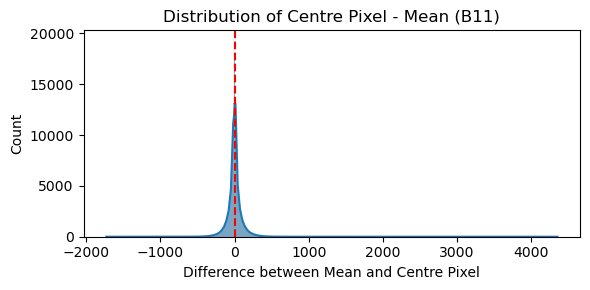

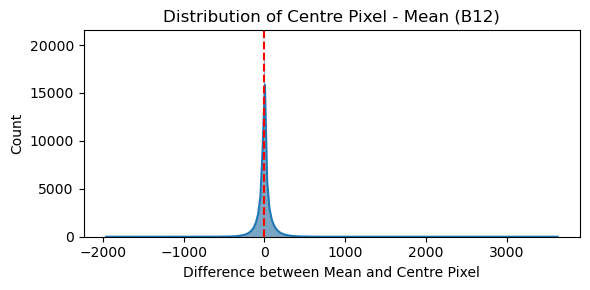

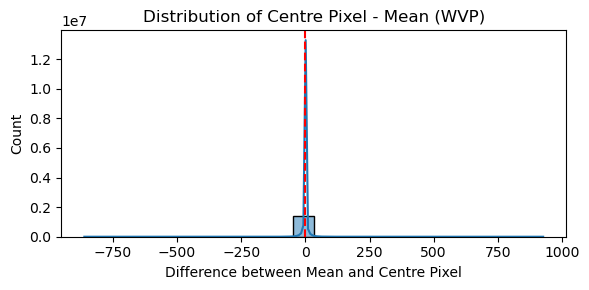

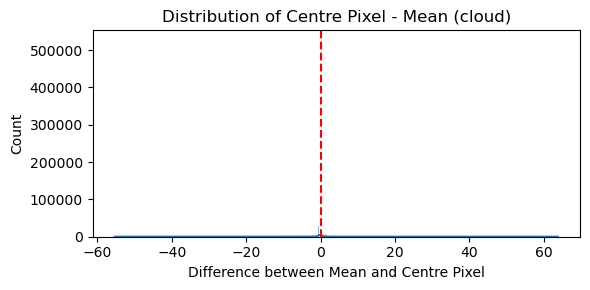

In [31]:
for band in bands:
    diff = df[f'{band}_center'] - df[f'{band}_mean']
    plt.figure(figsize=(6,3))
    sns.histplot(diff, kde=True)
    plt.axvline(0, color='red', linestyle='--')
    plt.title(f"Distribution of Centre Pixel - Mean ({band})")
    plt.xlabel("Difference between Mean and Centre Pixel")
    plt.ylabel("Count")
    plt.tight_layout()
    plt.savefig(f"./graphs/sentinel/centre_vs_mean/{band}.png", dpi=300)
    plt.show()

### What is the mean, STD and Variance of `cloud_patch_array`

In [33]:
# Summary of mean vs. the center value
statistics = pd.DataFrame()
for band in bands:
    # Normalise the values with z-score
    statistics[f"{band}_flat"] = df[f"{band}_array"].apply(lambda patch: [val for row in patch for val in row])
    all_values = [val for sublist in statistics[f"{band}_flat"] for val in sublist if pd.notnull(val)]
    band_min, band_max = min(all_values), max(all_values)
    statistics[f"{band}_norm"] = statistics[f"{band}_flat"].apply(lambda x: [(val - band_min) / (band_max - band_min) for val in x])
    statistics[f"{band}_std"] = statistics[f"{band}_norm"].apply(np.std)
    statistics[f"{band}_range"] = statistics[f"{band}_norm"].apply(lambda x: max(x) - min(x))
    plt.figure(figsize=(6,3))
    sns.histplot(statistics[f"{band}_std"], kde=True, color='lightgrey')
    plt.title(f"Distribution of Std Dev within 3×3 Patches ({band})")
    plt.xlabel("Standard Deviation")
    plt.ylabel("Count")
    plt.show()


TypeError: unsupported operand type(s) for -: 'str' and 'str'

### Scatterplot of Cloud Patch Size vs. Centre

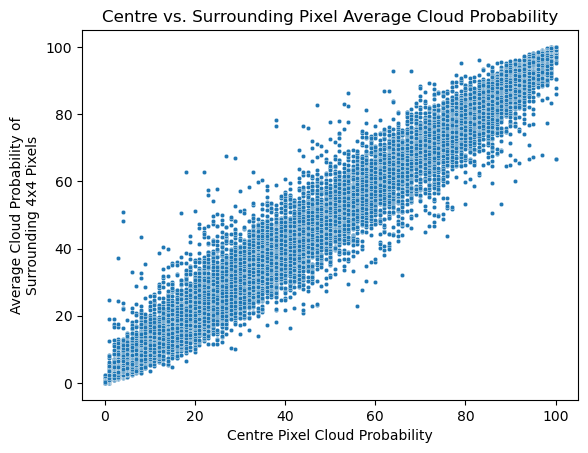

In [ ]:
plt.figure()
sns.scatterplot(data=df, x='cloud_center', y='cloud_mean', s=10)
plt.title("Centre vs. Surrounding Pixel Average Cloud Probability")
plt.xlabel("Centre Pixel Cloud Probability")
plt.ylabel("Average Cloud Probability of\nSurrounding 4x4 Pixels")
plt.show()

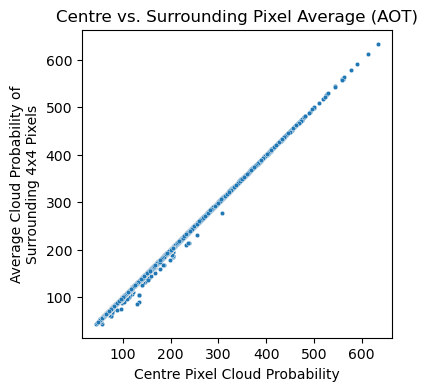

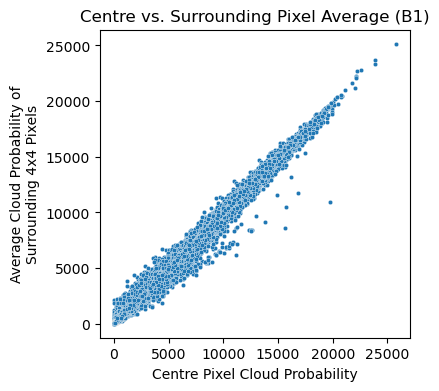

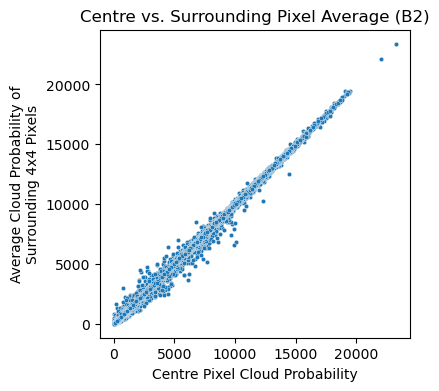

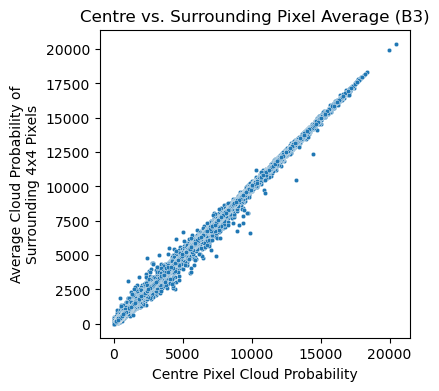

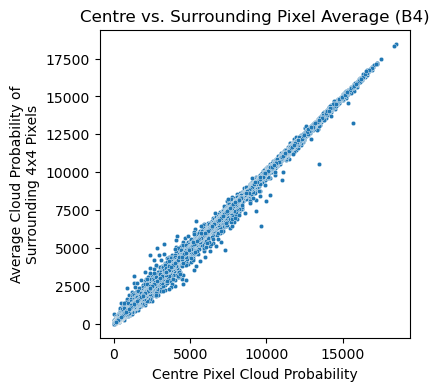

...

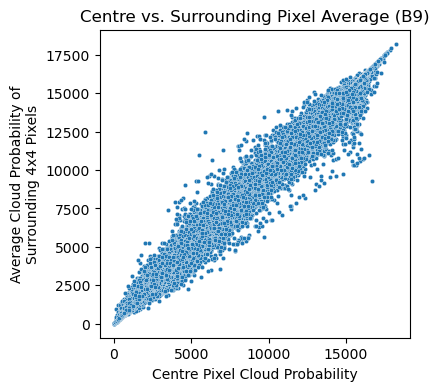

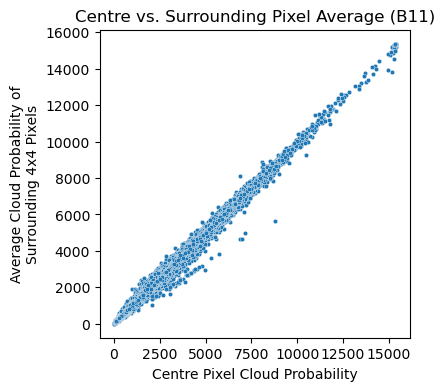

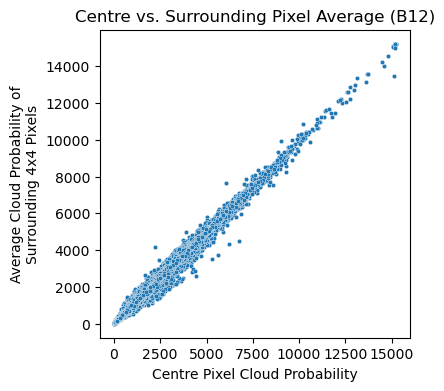

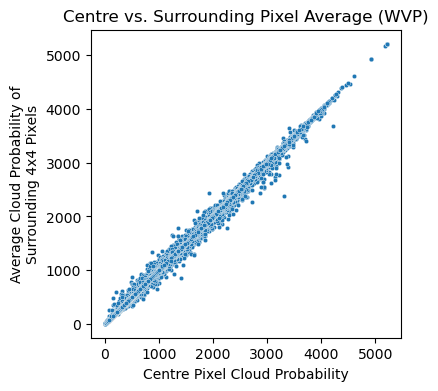

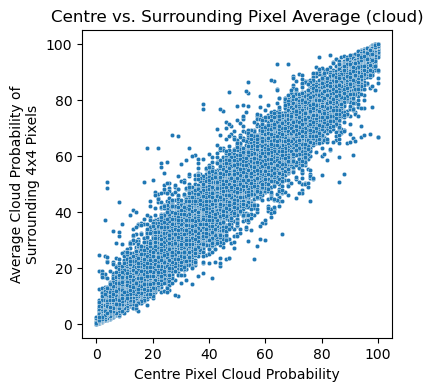

In [ ]:
for band in bands:
    plt.figure(figsize=(4,4))
    sns.scatterplot(data=df, x=f'{band}_center', y=f'{band}_mean', s=10)
    plt.title(f"Centre vs. Surrounding Pixel Average ({band})")
    plt.xlabel("Centre Pixel Cloud Probability")
    plt.ylabel("Average Cloud Probability of\nSurrounding 4x4 Pixels")
    plt.show()

## Visualise the Samples with a big difference between average and centre

In [34]:
for band in bands:
    sort_df = df.sort_values(by=f"{band}_diff", ascending=False)
    print(sort_df[[f"{band}_mean", f"{band}_array"]])

           AOT_mean                                          AOT_array
367775   329.444444  [[305, 324, 361], [302, 323, 360], [304, 326, ...
53894    148.000000  [[158, 148, 148], [153, 143, 143], [153, 143, ...
103637   138.333333  [[134, 134, 145], [134, 134, 145], [136, 136, ...
489744   129.888889  [[129, 126, 126], [129, 126, 126], [137, 135, ...
1354902  165.888889  [[162, 162, 170], [162, 162, 170], [166, 166, ...
...             ...                                                ...
549261   212.333333      [[0, 0, 0], [272, 272, 272], [365, 365, 365]]
549252   215.333333      [[0, 0, 0], [276, 276, 276], [370, 370, 370]]
424407   228.444444      [[0, 292, 393], [0, 293, 393], [0, 292, 393]]
549265   250.666667      [[0, 0, 0], [321, 321, 321], [431, 431, 431]]
549263   303.666667      [[0, 0, 0], [389, 389, 389], [522, 522, 522]]

[1394102 rows x 2 columns]
              B1_mean                                           B1_array
594933    5899.111111  [[1, 1, 9862], [1, 1, 99

### How many values come up for SCL in the array?

In [35]:
scl_df = pd.DataFrame()

In [36]:
scl_df['SCL_flat'] = df["SCL_array"].apply(lambda patch: [val for row in patch for val in row])
scl_df['unique_values_scl'] = scl_df['SCL_flat'].apply(lambda x: len(set(x)))
scl_df['length_array_scl'] = scl_df['SCL_flat'].apply(lambda x: len(x))

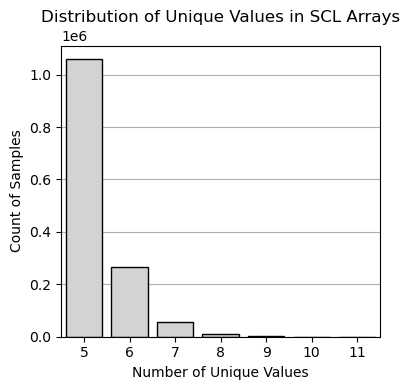

In [37]:
bar_data = scl_df['unique_values_scl'].value_counts().sort_index()

# Plot
fig, ax = plt.subplots()
fig.set_figwidth(4)
fig.set_figheight(4)
sns.barplot(x=bar_data.index.astype(str), y=bar_data.values, color='lightgrey', edgecolor='black')
plt.title("Distribution of Unique Values in SCL Arrays")
plt.xlabel("Number of Unique Values")
plt.ylabel("Count of Samples")
plt.grid(True, axis='y')  # Enable horizontal grid
ax.set_axisbelow(True)
plt.tight_layout()
plt.show()

## Select Means and Modes only

In [40]:
# Calculate the mode of SCL
df['SCL_mode'] = df['SCL_array'].apply(lambda x: stats.mode([val for row in x for val in row]))

bands_mean = [f"{band}_mean" for band in bands]
select_bands = ['point_id', 'survey_date', 'image_date', 'SCL_mode'] + bands_mean

mean_df = df[select_bands]

## Calculate Moisture Index and NDVI

In [48]:
mean_df['NDVI'] = (mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'])
mean_df['moisture_index'] = (mean_df['B8A_mean'] - mean_df['B11_mean']) / (mean_df['B8A_mean'] + mean_df['B11_mean']) 
mean_df['EVI'] = 2.5 * ((mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + 6 * mean_df['B4_mean'] - 7.5 * mean_df['B2_mean'] + 1))
mean_df['SAVI'] = ((mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'] + 0.5)) * 1.5

/var/folders/2w/cw97zdb154l5t4cjzcg4xx8m0000gn/T/ipykernel_37452/819534138.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mean_df['NDVI'] = (mean_df['B8_mean'] - mean_df['B4_mean']) / (mean_df['B8_mean'] + mean_df['B4_mean'])
/var/folders/2w/cw97zdb154l5t4cjzcg4xx8m0000gn/T/ipykernel_37452/819534138.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mean_df['moisture_index'] = (mean_df['B8A_mean'] - mean_df['B11_mean']) / (mean_df['B8A_mean'] + mean_df['B11_mean'])
/var/folders/2w/cw97zdb154l5t4cjzcg4

## Save as CSV

In [42]:
checkpoint1 = mean_df.copy()

In [50]:
SENTINEL_CSV_PROCESSED = "data/modelling/365day_datasets/processed/20250803_sentinel2_365days_mean.csv"

In [51]:
# Save sentinel as CSV
mean_df.to_csv(SENTINEL_CSV_PROCESSED, index=False)

In [53]:
mean_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1394102 entries, 0 to 1404271
Data columns (total 23 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   point_id        1394102 non-null  int64  
 1   survey_date     1394102 non-null  object 
 2   image_date      1394102 non-null  object 
 3   SCL_mode        1394102 non-null  object 
 4   AOT_mean        1394102 non-null  float64
 5   B1_mean         1394102 non-null  float64
 6   B2_mean         1394102 non-null  float64
 7   B3_mean         1394102 non-null  float64
 8   B4_mean         1394102 non-null  float64
 9   B5_mean         1394102 non-null  float64
 10  B6_mean         1394102 non-null  float64
 11  B7_mean         1394102 non-null  float64
 12  B8_mean         1394102 non-null  float64
 13  B8A_mean        1394102 non-null  float64
 14  B9_mean         1394102 non-null  float64
 15  B11_mean        1394102 non-null  float64
 16  B12_mean        1394102 non-null  float64

In [45]:
len(mean_df)

1394102

# Load CSV

In [3]:
df = pd.read_csv(SENTINEL_CSV_PROCESSED)

In [4]:
df['survey_date'] = pd.to_datetime(df['survey_date'])
df['image_date'] = pd.to_datetime(df['image_date'])

df['days_diff'] = (df['survey_date'] - df['image_date']).dt.days

In [5]:
len(df)

161805

# Exploration

## Cloud Cover across all images

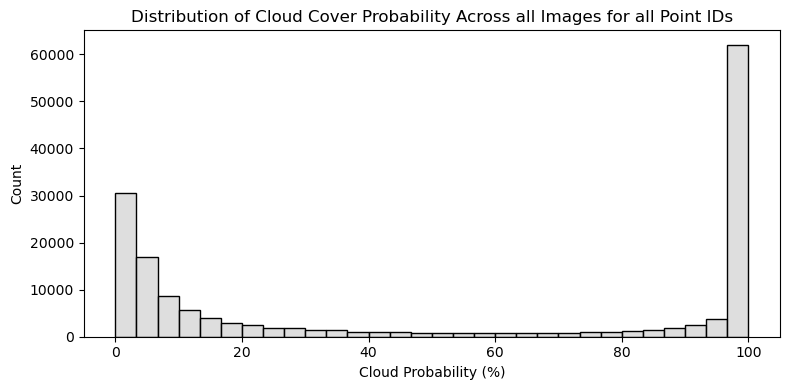

In [6]:
plt.figure(figsize=(8, 4))
sns.histplot(df['cloud_mean'], bins=30, color='lightgrey')
plt.xlabel('Cloud Probability (%)')
plt.title("Distribution of Cloud Cover Probability Across all Images for all Point IDs")
plt.tight_layout()
plt.savefig("./graphs/sentinel/histplot_cloudmean.png", dpi=300)
plt.show()

## Cloud Cover vs band correlation 

B1_mean     0.760009
B2_mean     0.755512
B3_mean     0.746849
B4_mean     0.736700
B5_mean     0.731672
B9_mean     0.718034
B6_mean     0.701778
B7_mean     0.682005
B8_mean     0.674451
B8A_mean    0.666295
B12_mean    0.613910
B11_mean    0.514956
Name: cloud_mean, dtype: float64


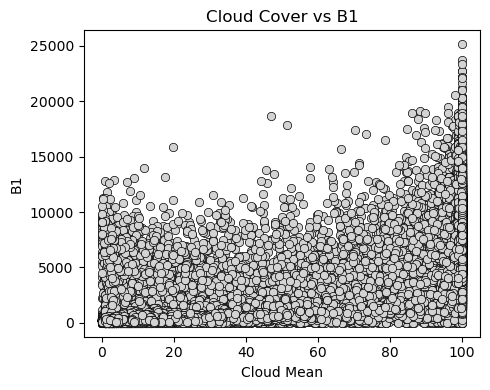

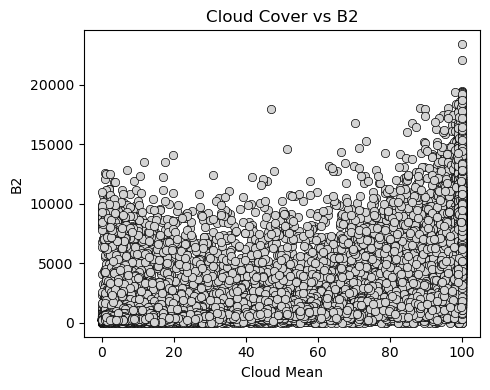

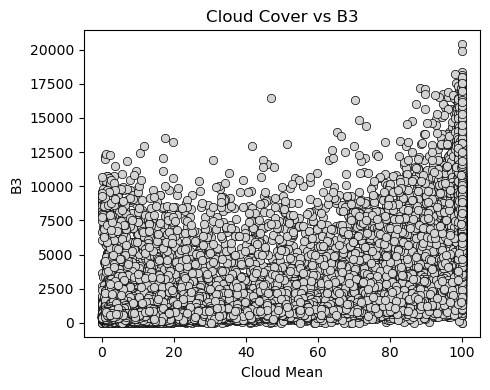

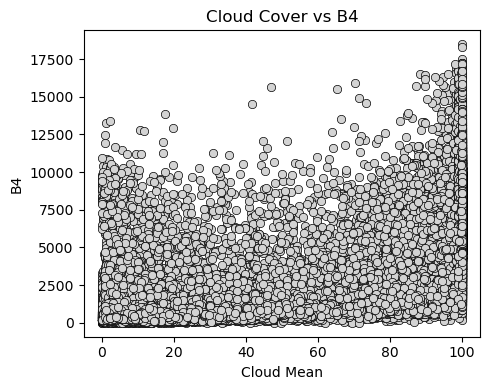

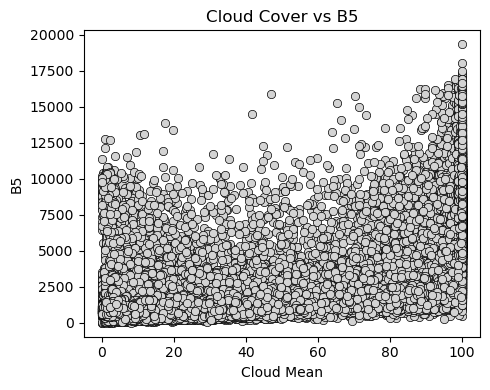

...

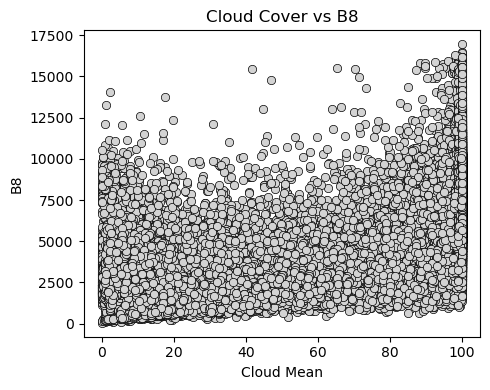

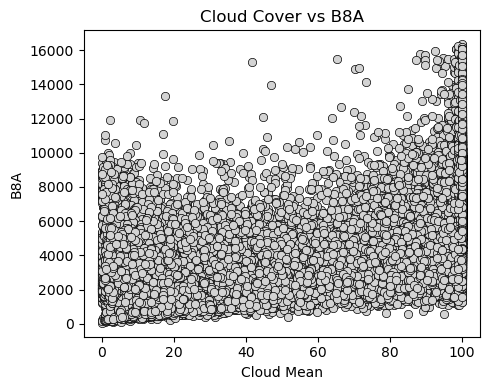

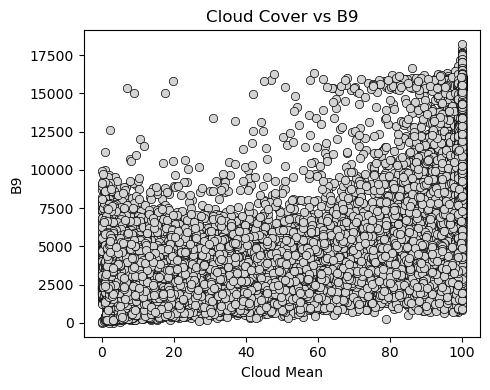

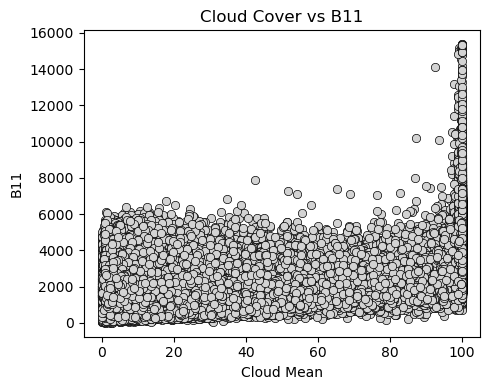

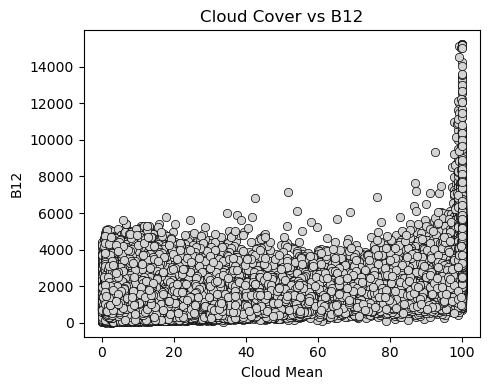

In [7]:
# Band columns
band_cols = ['B1_mean', 'B2_mean', 'B3_mean', 'B4_mean', 'B5_mean', 'B6_mean',
             'B7_mean', 'B8_mean', 'B8A_mean', 'B9_mean', 'B11_mean', 'B12_mean']

# Compute the correlation matrix
df_band_corr = df[['cloud_mean'] + band_cols]
correlations = df_band_corr.corr().loc['cloud_mean', band_cols].sort_values(ascending=False)
print(correlations)

# Plot scatter plots
for band in band_cols:
    plt.figure(figsize=(5,4))
    sns.scatterplot(data=df, x='cloud_mean', y=band,
                    color='lightgrey', edgecolor='black', linewidth=0.5)
    plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
    plt.xlabel('Cloud Mean')
    plt.ylabel(f'{band.replace("_mean", "")}')
    plt.tight_layout()
    plt.savefig(f"./graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
    plt.show()

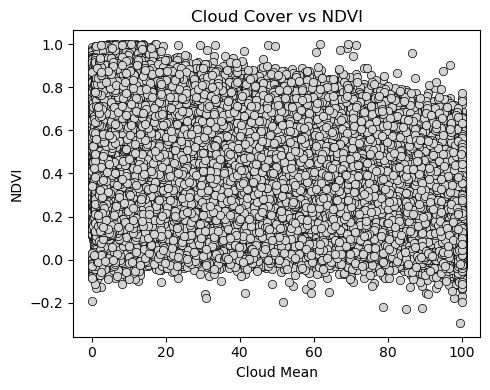

In [17]:
# Plot scatter plots
band='NDVI'
plt.figure(figsize=(5,4))
sns.scatterplot(data=df, x='cloud_mean', y=band,
                color='lightgrey', edgecolor='black', linewidth=0.5)
plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
plt.xlabel('Cloud Mean')
plt.ylabel(f'{band.replace("_mean", "")}')
plt.tight_layout()
plt.savefig(f"./graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
plt.show()

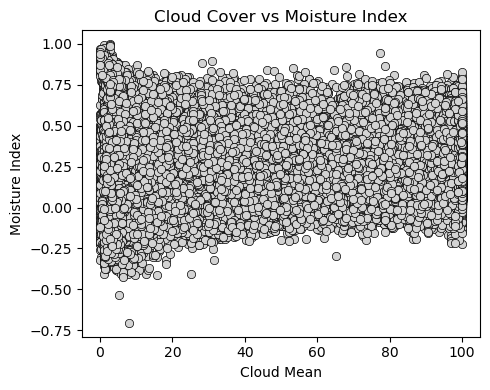

In [19]:
# Plot scatter plots
band='moisture_index'
plt.figure(figsize=(5,4))
sns.scatterplot(data=df, x='cloud_mean', y=band,
                color='lightgrey', edgecolor='black', linewidth=0.5)
plt.title(f'Cloud Cover vs Moisture Index')
plt.xlabel('Cloud Mean')
plt.ylabel(f'Moisture Index')
plt.tight_layout()
plt.savefig(f"./graphs/sentinel/cloudmean_vs_bands_scatter/{band}.png", dpi=300)
plt.show()

B1_mean     0.760009
B2_mean     0.755512
B3_mean     0.746849
B4_mean     0.736700
B5_mean     0.731672
B9_mean     0.718034
B6_mean     0.701778
B7_mean     0.682005
B8_mean     0.674451
B8A_mean    0.666295
B12_mean    0.613910
B11_mean    0.514956
Name: cloud_mean, dtype: float64


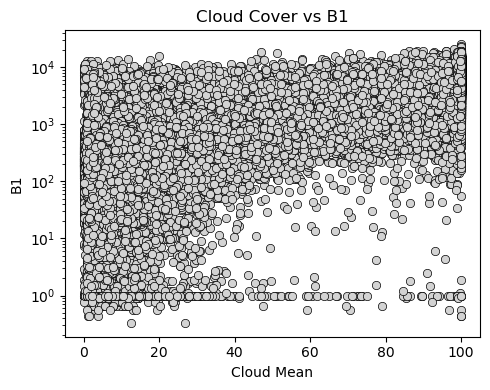

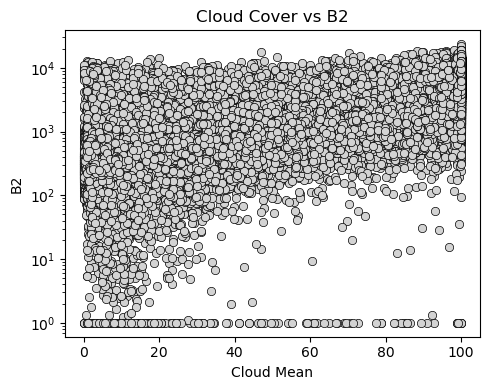

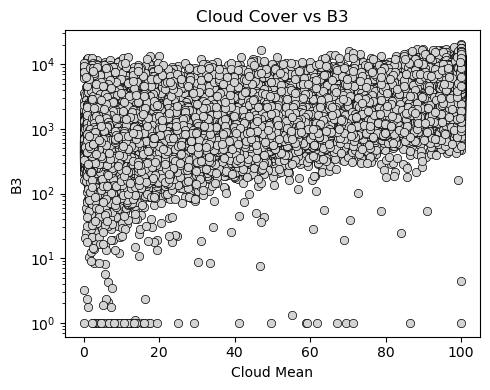

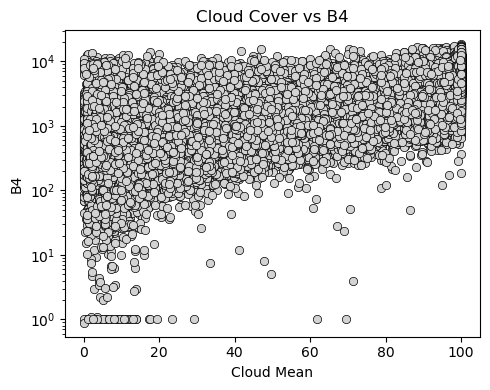

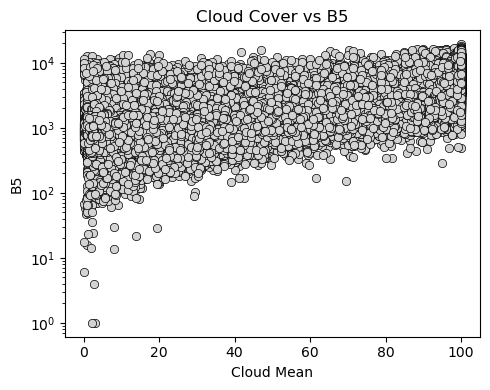

...

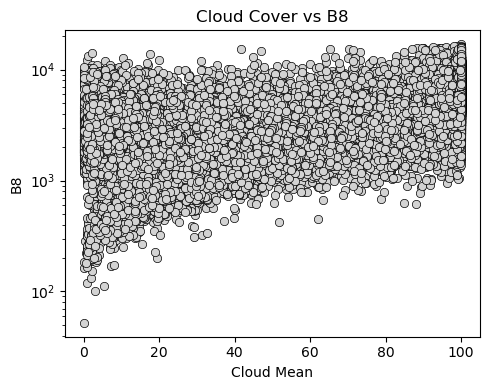

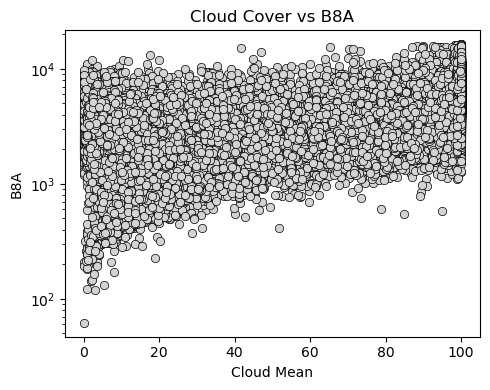

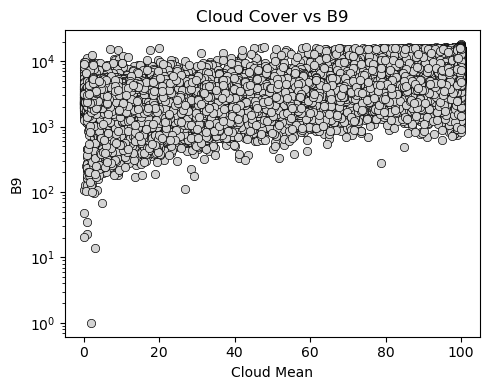

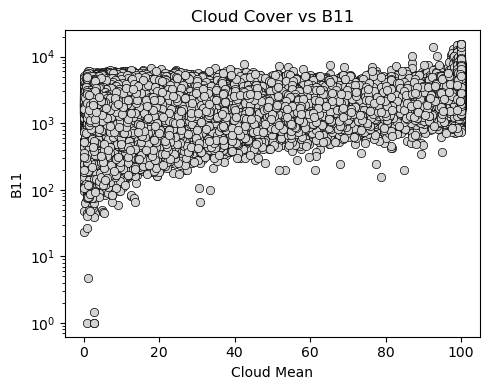

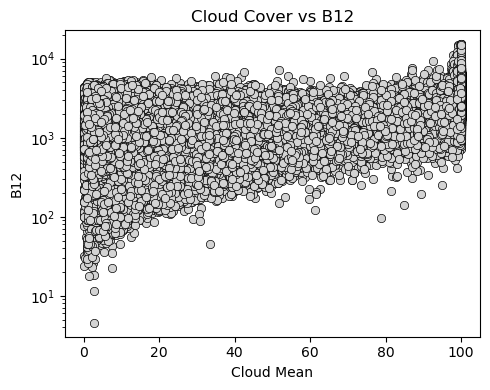

In [16]:
# Band columns
band_cols = ['B1_mean', 'B2_mean', 'B3_mean', 'B4_mean', 'B5_mean', 'B6_mean',
             'B7_mean', 'B8_mean', 'B8A_mean', 'B9_mean', 'B11_mean', 'B12_mean']

# Compute the correlation matrix
df_band_corr = df[['cloud_mean'] + band_cols]
correlations = df_band_corr.corr().loc['cloud_mean', band_cols].sort_values(ascending=False)
print(correlations)

# Plot scatter plots
for band in band_cols:
    plt.figure(figsize=(5,4))
    sns.scatterplot(data=df, x='cloud_mean', y=band,
                    color='lightgrey', edgecolor='black', linewidth=0.5)
    plt.title(f'Cloud Cover vs {band.replace("_mean", "")}')
    plt.xlabel('Cloud Mean')
    plt.yscale('log')
    plt.ylabel(f'{band.replace("_mean", "")}')
    plt.tight_layout()
    plt.savefig(f"./graphs/sentinel/logbands_cloudmean_vs_bands_scatter_{band}.png", dpi=300)
    plt.show()

## Number of Images with 100% Cloud Cover

In [21]:
all_images_cloud = len(df[df['cloud_mean']==100])
print(f"{all_images_cloud} out of {len(df)} images have 100% cloud cover probability.")

40621 out of 161805 images have 100% cloud cover probability.


In [47]:
unique_point_fullcloud = df[df['cloud_mean']==100]['point_id'].nunique()
print(f"Number of Point IDs with images that have 100% cloud cover: {unique_point_fullcloud}")

Number of Point IDs with images that have 100% cloud cover: 15947


## Point IDs Affected by Cloud Cover

In [8]:
cloud_threshold = 0.2

cloudy_points = df[df['cloud_mean'] > cloud_threshold]['point_id'].nunique()
total_points = df['point_id'].nunique()

print(f"{cloudy_points} out of {total_points} point IDs have at least one cloudy image.")

15877 out of 15877 point IDs have at least one cloudy image.


In [9]:
cloud_threshold = 0.2

cloudy_points = df[df['cloud_mean'].astype(float) < cloud_threshold]['point_id'].nunique()
total_points = df['point_id'].nunique()

print(f"{cloudy_points} out of {total_points} point IDs have at least one clearer image.")

509 out of 15877 point IDs have at least one clearer image.


## Cloudy Images Per Point ID

In [10]:
cloud_threshold = 0.2

cloudy_images_per_point = df[df['cloud_mean'] > cloud_threshold].groupby('point_id').size()

print(cloudy_images_per_point.describe())

count    15877.000000
mean        10.144927
std          3.484620
min          1.000000
25%          6.000000
50%         11.000000
75%         12.000000
max         25.000000
dtype: float64


In [11]:
# Number of images per point
count_df = df.groupby(['point_id']).agg('count').reset_index().rename(columns={'image_date': 'image_count'})[['point_id', 'image_count']]
count_df['image_count'].describe()

count    15877.000000
mean        10.191157
std          3.502229
min          1.000000
25%          6.000000
50%         11.000000
75%         12.000000
max         25.000000
Name: image_count, dtype: float64

## Time Between Images per Point ID

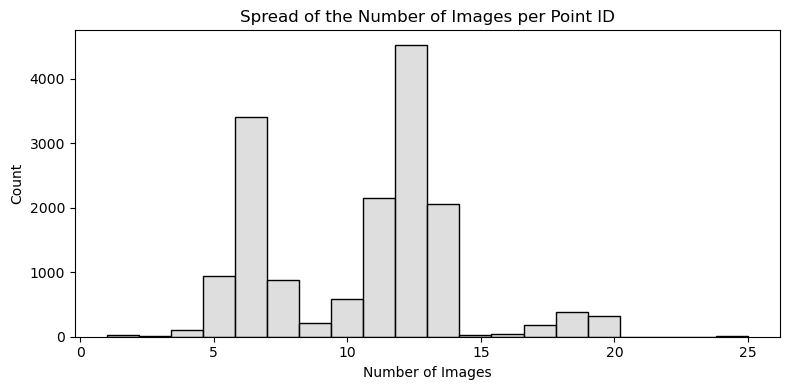

In [12]:
plt.figure(figsize=(8, 4))
sns.histplot(count_df['image_count'], bins=20, color="lightgrey")
plt.xlabel("Number of Images")
plt.title("Spread of the Number of Images per Point ID")
plt.tight_layout()
plt.savefig("./graphs/sentinel/histplot_image_count_per_point.png", dpi=300)
plt.show()

In [13]:
# Sort by more recent images per point, calculate time between each 
df_sorted = df.sort_values(by=['point_id', 'image_date'])
df_sorted['time_diff'] = df_sorted.groupby('point_id')['image_date'].diff().dt.days

# Average the time between images per point
avg_time_between_images = df_sorted.groupby('point_id')['time_diff'].mean()

print(avg_time_between_images.describe())

count    15854.000000
mean         3.419928
std          1.328354
min          1.000000
25%          2.500000
50%          2.700000
75%          5.000000
max         14.000000
Name: time_diff, dtype: float64


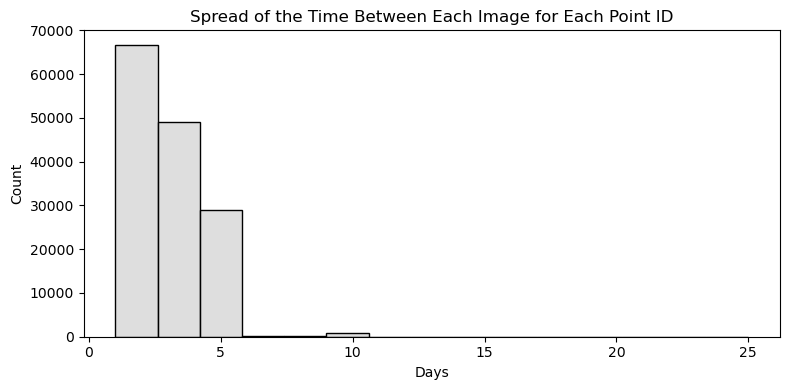

In [14]:
plt.figure(figsize=(8, 4))
sns.histplot(df_sorted['time_diff'], bins=15, color="lightgrey")
plt.xlabel("Days")
plt.title("Spread of the Time Between Each Image for Each Point ID")
plt.tight_layout()
plt.savefig("./graphs/sentinel/histplot_time_between_images.png", dpi=300)
plt.show()

# Select Most Recent Images

### Create Column: days between survey date and satellite image taken

In [56]:
df = mean_df.copy()

In [57]:
# Calculate the days between the footage for sentinel 
df['image_date'] = pd.to_datetime(df['image_date'])
df['survey_date'] = pd.to_datetime(df['survey_date'])

df['days_diff'] = (df['image_date'] - df['survey_date']).dt.days

In [58]:
# Select the closest day
dup_cols = ['point_id', 'survey_date']
closest = df.groupby(dup_cols, as_index=False)['days_diff'].max()
closest = closest.merge(df, how='left', on=['point_id', 'survey_date', 'days_diff'])

In [59]:
print(f"Number of samples: {len(closest)}")
print(f"Number of unique point IDs: {closest['point_id'].nunique()}")

Number of samples: 15877
Number of unique point IDs: 15877


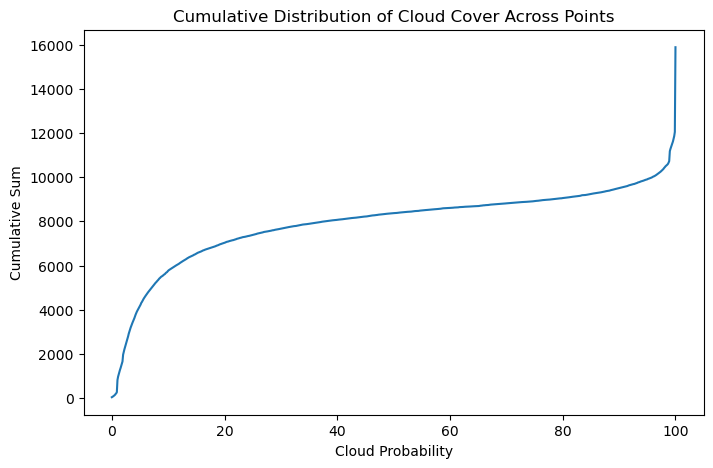

In [61]:
#plot the number of points with each level of cloud cover:
plot_df = closest.groupby('cloud_mean', as_index=False).agg('count')
plot_df['cum_sum'] = plot_df['point_id'].cumsum() 

plt.figure(figsize=(8,5))
sns.lineplot(data=plot_df, x='cloud_mean', y='cum_sum')
plt.title("Cumulative Distribution of Cloud Cover Across Points")
plt.xlabel("Cloud Probability")
plt.ylabel("Cumulative Sum")

plt.show()

## Merge with the Soil DataFrame

In [62]:
merged = closest.merge(soil, how='inner', left_on=['point_id'], right_on=['POINTID'])
len(merged)

15864

### Visualise Cloud Cover by Location

In [64]:
cloud_df = merged.copy()
cloud_df['geometry'] = cloud_df.apply(lambda row: Point(row['gps_long'], row['gps_lat']), axis=1)
gdf = gpd.GeoDataFrame(cloud_df, geometry='geometry', crs='EPSG:4326')

In [66]:
m = folium.Map(location=[gdf['gps_lat'].mean(), gdf['gps_long'].mean()], zoom_start=5)
# Create a color map based on cloud_probability
min_cloud = gdf['cloud_mean'].min()
max_cloud = gdf['cloud_mean'].max()
colormap = cm.LinearColormap(
    colors=cm.linear.RdYlGn_11.colors[::-1],  # reverse color list
    vmin=min_cloud,
    vmax=max_cloud
).to_step(n=10)

# Add points
for _, row in gdf.iterrows():
    color = colormap(row['cloud_mean']) if pd.notnull(row['cloud_mean']) else "#808080"
    folium.CircleMarker(
        location=[row['gps_lat'], row['gps_long']],
        radius=0.5,
        color=color,
        fill=True,
        fill_opacity=0.7,
        popup=f"Cloud: {row['cloud_mean']}%"
    ).add_to(m)

# Add color legend
colormap.caption = "Cloud Probability (%)"
colormap.add_to(m)

m

## Cloud Cover Type

In [67]:
# Add the land cover mapping to the closest_df

scl_map = {1: 'Saturated / Defective',
           2: 'Dark Area Pixels',
           3: 'Cloud Shadows',
           4: 'Vegetation',
           5: 'Bare Soils',
           6: 'Water',
           7: 'Clouds Low Probability / Unclassified',
           8: 'Clouds Medium Probability',
           9: 'Clouds High Probability',
           10: 'Cirrus',
           11: 'Snow / Ice'}

merged['scl_mapped'] = merged['SCL_mode'].replace(scl_map)

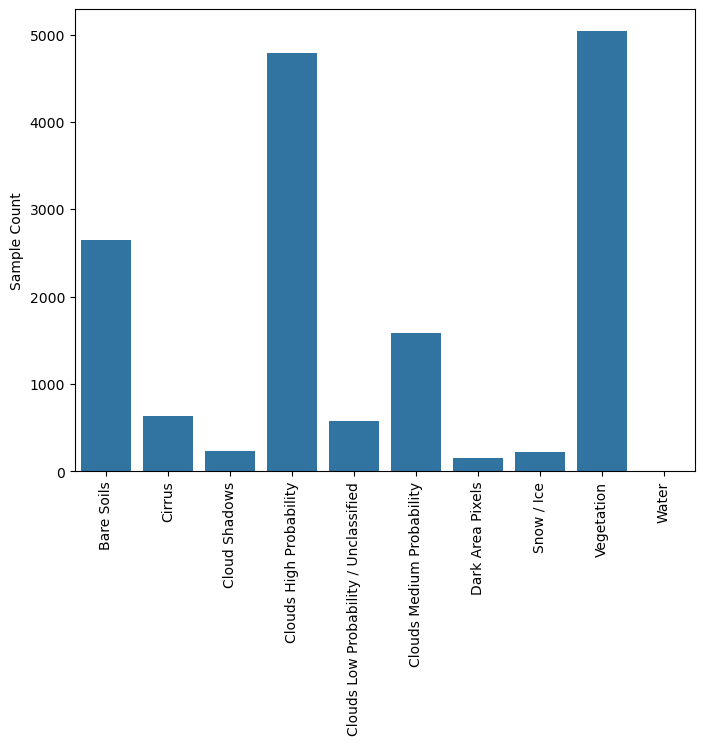

In [70]:
count_df = merged.groupby('scl_mapped', as_index=False).agg('count')

plt.figure(figsize=(8,6))
sns.barplot(data=count_df, x='scl_mapped', y='cloud_mean')
plt.xticks(rotation=90)
plt.ylabel("Sample Count")
plt.xlabel("")
plt.show()

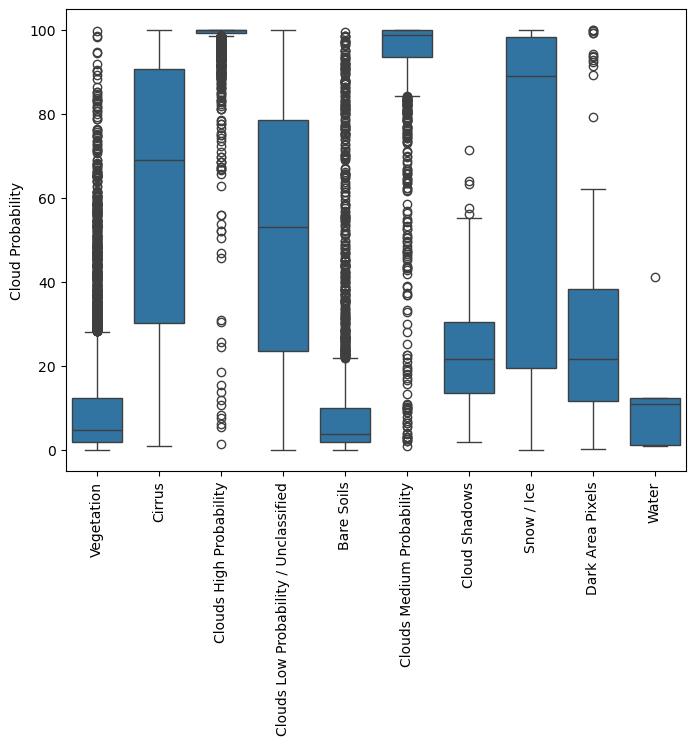

In [71]:
plt.figure(figsize=(8,6))
sns.boxplot(data=merged, x='scl_mapped', y='cloud_mean')
plt.xticks(rotation=90)
plt.ylabel("Cloud Probability")
plt.xlabel("")
plt.show()

### Most common combinations

In [135]:
merged['scl_patch_array'].apply(lambda x: set(x)).value_counts()


scl_patch_array
{9}              4535
{4}              4019
{5}              1886
{8}              1283
{4, 5}           1135
                 ... 
{8, 9, 10, 5}       1
{2, 3, 5}           1
{8, 9, 11}          1
{8, 10, 4, 7}       1
{9, 4, 7}           1
Name: count, Length: 88, dtype: int64

In [28]:
def view_random_image(
        df,
        cloud_cover: int,
        point_id,
        buffer_radius: int = 600,
        zoom: int = 15
    ):
    
    if point_id is None:
        samples = df[df['cloud_probability'] == cloud_cover]
        sample = samples.sample(random_state=42).iloc[0].to_dict()
    else:
        sample = df[df['point_id'] == point_id].iloc[0].to_dict()
    
    lon, lat = sample['gps_long'], sample['gps_lat']
    img_date = pd.to_datetime(sample['image_date'])
    end = img_date + DateOffset(days=1)

    point = ee.Geometry.Point([lon, lat])
    aoi = point.buffer(buffer_radius).bounds()

    collection = (
        ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
        .filterBounds(aoi)
        .filterDate(img_date.strftime('%Y-%m-%d'), end.strftime('%Y-%m-%d'))
        .distinct('system:time_start')
    )

    image_count = collection.size().getInfo()
    print(f"Point ID: {sample['point_id']}")
    print(f"SCL: {sample['scl_mapped']}")
    print(f"Images found: {image_count}")
    if image_count == 0:
        raise ValueError("No Sentinel-2 images found for the selected date.")

    # Get first image and extract acquisition date
    image_list = collection.toList(collection.size())
    image = ee.Image(image_list.get(0))
    collected_date = pd.to_datetime(image.get('system:time_start').getInfo(), unit='ms')
    print(f"Image date = {collected_date}")

    # Select RGB bands and clip to AOI
    rgb_image = image.select(['B2', 'B3', 'B4']).clip(aoi)
    vis_params = {'min': 0, 'max': 3000, 'bands': ['B4', 'B3', 'B2']}

    # Create and return map
    m = geemap.Map(center=[lat, lon], zoom=zoom)
    m.addLayer(rgb_image, vis_params, f"Sentinel-2 RGB ({collected_date.strftime('%Y-%m-%d')})")
    return m

In [29]:
coord_df.head()

NameError: name 'coord_df' is not defined

In [27]:
cloud_cover = 20
point_id = 35442124

buffer_radius = 400
zoom = 17

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

NameError: name 'view_random_image' is not defined

In [139]:
cloud_cover = 50
point_id = None

buffer_radius = 1000
zoom = 15

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 43623698
SCL: Vegetation
Images found: 1
Image date = 2018-05-18 10:40:24


Map(center=[56.38375, 10.66319], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [140]:
cloud_cover = 51
point_id = None

buffer_radius = 1000
zoom = 15

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 44844130
SCL: Clouds Medium Probability
Images found: 1
Image date = 2018-02-09 10:31:52.455000


Map(center=[60.24018, 12.93542], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [141]:
cloud_cover = 21
point_id = None

buffer_radius = 1000
zoom = 15

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 39722908
SCL: Vegetation
Images found: 1
Image date = 2018-06-05 10:56:54.103000


Map(center=[49.1828, 5.210141], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=SearchD…

In [142]:
cloud_cover = 31
point_id = None

buffer_radius = 800
zoom = 15

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 47763266
SCL: Vegetation
Images found: 1
Image date = 2018-05-21 10:00:24.464000


Map(center=[52.31546, 16.68295], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [144]:
cloud_cover = 31
point_id = None

buffer_radius = 50
zoom = 19

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 47763266
SCL: Vegetation
Images found: 1
Image date = 2018-05-21 10:00:24.464000


Map(center=[52.31546, 16.68295], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

In [146]:
cloud_cover = 16
point_id = None

buffer_radius = 500
zoom = 17

m = view_random_image(coord_df, cloud_cover=cloud_cover, point_id=point_id, buffer_radius=buffer_radius, zoom=zoom)
m

Point ID: 52002906
SCL: Vegetation
Images found: 1
Image date = 2018-07-19 09:44:30.575000


Map(center=[48.62255, 21.97906], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Search…

## Extract Sentinel 2 Surface Band Values

### Stratified Sampling of pandas dataframe

By country - proportional number of samples from each. 

In [10]:
stratified = df.groupby('country_name', group_keys=False).apply(lambda x: x.sample(frac=0.1, random_state=RANDOM_STATE))

In [11]:
print(f"Length of original dataframe: {len(df)}")
print(f"Length of sampled dataframe: {len(stratified)}")

Length of original dataframe: 17124
Length of sampled dataframe: 1713


### Extract number of images before and after - Cloud Pixels only - surrounding areas. THIS CODE WORKS

In [47]:
# Select row and the time window for image collection
row = stratified.iloc[0]
min_date = 'minus_30_days'
max_date = 'plus_30_days'
survey_date = 'SURVEY_DATE'

CLD_PRB_THRESH = 50
NIR_DRK_THRESH = 0.15
CLD_PRJ_DIST = 1
BUFFER = 50

# Create a point from the latitude and longitude
point = ee.Geometry.Point(row['gps_long'], row['gps_lat'])

In [15]:
# Centre pixel ONLY

# Extract from Surface Reflection 
s2 = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED") \
    .filterDate(row[min_date], row[max_date]) \
    .filterBounds(point)

s2_clouds = ee.ImageCollection("COPERNICUS/S2_CLOUD_PROBABILITY") \
    .filterDate(row[min_date], row[max_date]) \
    .filterBounds(point)

# Create a join between the two images
joined = ee.ImageCollection(ee.Join.saveFirst('cloud_img').apply(
    s2, s2_clouds,
    ee.Filter.equals(leftField='system:index', rightField='system:index')
    ))

# Loop through the images
utc_dates = s2.aggregate_array("system:time_start").getInfo()
dates = pd.to_datetime(utc_dates, unit='ms') # COnvert to pandas datetime
clouds = s2.aggregate_array("CLOUDY_PIXEL_PERCENTAGE").getInfo()
ids = s2.aggregate_array("system:index").getInfo()


In [16]:
s2_images = joined.select(bands)
image_list = s2_images.toList(s2_images.size())

imgs = [ee.Image(image_list.get(i)) for i in range(image_list.size().getInfo())]

In [31]:
# CLoudy probability only
cloud_images = s2_clouds.toList(s2_clouds.size())
cloud_imgs = [ee.Image(cloud_images.get(i)) for i in range(cloud_images.size().getInfo())]
# cloud_imgs_sample = cloud_imgs[:2]
# for i in range(len(cloud_imgs_sample)):
#     img = cloud_imgs[i]
#     center = img.sample(point, scale=10)
#     cloud_center = ee.Algorithms.If(center, center.get('probability'), None).getInfo()

kernel = ee.Kernel.square(1)

results = []

for i in range(cloud_images.size().getInfo()):
    img = ee.Image(cloud_images.get(i))
    img_id = img.get('system:index').getInfo()
    date = ee.Date(img.get('system:time_start')).format('YYYY-MM-dd').getInfo()

    # Center pixel
    center_sample = img.sample(point, scale=10).first()
    cloud_center = ee.Algorithms.If(
        center_sample,
        center_sample.get('probability'),
        None
    ).getInfo()

    # 3x3 neighborhood
    array_img = img.select('probability').neighborhoodToArray(kernel)
    patch_sample = array_img.sample(point, scale=10).first()

    cloud_patch_array = ee.Algorithms.If(
        patch_sample,
        patch_sample.get('probability'),
        None
    ).getInfo()

    results.append({
        'image_id': img_id,
        'image_date': date,
        'cloud_prob_center': cloud_center,
        'cloud_prob_3x3_array': cloud_patch_array
    })

df = pd.DataFrame(results)


In [32]:
df.head()

,image_id,image_date,cloud_prob_center,cloud_prob_3x3_array
0,20180508T095029_20180508T095028_T33TWN,2018-05-08,100.0,"[[100, 100, 100], [100, 100, 100], [100, 100, ..."
1,20180511T100029_20180511T100713_T33TWN,2018-05-11,100.0,"[[100, 100, 100], [100, 100, 100], [100, 100, ..."
2,20180513T095031_20180513T095705_T33TWN,2018-05-13,23.0,"[[27, 36, 24], [25, 23, 20], [21, 22, 26]]"
3,20180516T100031_20180516T100706_T33TWN,2018-05-16,88.0,"[[87, 90, 90], [89, 88, 89], [91, 87, 87]]"
4,20180518T095029_20180518T095208_T33TWN,2018-05-18,100.0,"[[100, 100, 100], [100, 100, 100], [100, 100, ..."


### Select Centre pixel only - cloud cover probability and land cover

In [81]:
# Create a point from the latitude and longitude
row = stratified.iloc[0]
min_date = 'minus_30_days'
max_date = 'plus_30_days'
survey_date = 'SURVEY_DATE'
point = ee.Geometry.Point(row['gps_long'], row['gps_lat'])

start_date = row[min_date]
end_date = row[survey_date]
point_id = row['POINTID']
survey_date = row[survey_date]

save_path = "./data/preprocessing/scl_cloudprob_results.txt"

if not os.path.exists("./data/preprocessing"):
    os.makedirs("./data/preprocessing")


In [88]:
cloud_col = ee.ImageCollection("COPERNICUS/S2_CLOUD_PROBABILITY") \
    .filterDate(start_date, end_date) \
    .filterBounds(point)

sr_col = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED") \
    .filterDate(start_date, end_date) \
    .filterBounds(point)

join = ee.Join.saveFirst('cloud_img')
joined = ee.ImageCollection(join.apply(sr_col, cloud_col,
    ee.Filter.equals(leftField='system:index', rightField='system:index')))
joined = joined.distinct('system:time_start')

# Convert images to a list
image_list = joined.toList(joined.size())

In [89]:
# Loop through the images
utc_dates = joined.aggregate_array("system:time_start").getInfo()
dates = pd.to_datetime(utc_dates, unit='ms') # COnvert to pandas datetime
clouds = joined.aggregate_array("CLOUDY_PIXEL_PERCENTAGE").getInfo()
ids = joined.aggregate_array("system:index").getInfo()

In [92]:
imgs = [ee.Image(image_list.get(i)) for i in range(image_list.size().getInfo())]

for i in range(len(imgs)):
    img = imgs[i]
    
    img_id = ids[i]
    date = dates[i]

    try:
        cloud_img = ee.Image(img.get('cloud_img'))
        # Combine cloud prob and SCL into one image for sampling
        composite = cloud_img.select('probability').addBands(img.select('SCL'))

        # Sample both at once at center pixel
        sample = composite.sample(point, scale=10).first()

        if sample:
            props = sample.toDictionary().getInfo()
            cloud_prob = props.get('probability')
            scl_val = props.get('SCL')

            results_dict = {
                'point_id': row['POINTID'],
                'survey_date': row['SURVEY_DATE'],
                'image_id': img_id,
                'image_date': date,
                'cloud_probability': float(cloud_prob) if cloud_prob is not None else None,
                'scl': int(scl_val) if scl_val is not None else None,
            }
    except Exception as e:
        results_dict = {
                'point_id': row['POINTID'],
                'survey_date': row['SURVEY_DATE'],
                'image_id': img_id,
                'image_date': date,
                'cloud_probability': None,
                'scl': None
                }
        
    else:
        with open(save_path, 'a') as f:
            f.write(json.dumps(results_dict, default=str))
            f.write('\n')
        print(f"Saved: {img_id} - SCL: {scl_val}, Cloud Prob: {cloud_prob}")

Saved: 20180109T101401_20180109T101536_T33UVP - SCL: 10, Cloud Prob: 23
Saved: 20180111T100349_20180111T100351_T33UVP - SCL: 2, Cloud Prob: 53
Saved: 20180114T101349_20180114T101347_T33UVP - SCL: 8, Cloud Prob: 95
Saved: 20180116T100341_20180116T100417_T33UVP - SCL: 11, Cloud Prob: 93
Saved: 20180119T101331_20180119T101331_T33UVP - SCL: 10, Cloud Prob: 87
Saved: 20180121T100319_20180121T100542_T33UVP - SCL: 9, Cloud Prob: 100
Saved: 20180126T100301_20180126T100258_T33UVP - SCL: 9, Cloud Prob: 100
Saved: 20180129T101251_20180129T101247_T33UVP - SCL: 9, Cloud Prob: 99
Saved: 20180131T100229_20180131T100231_T33UVP - SCL: 9, Cloud Prob: 99
Saved: 20180203T101219_20180203T101237_T33UVP - SCL: 9, Cloud Prob: 100
Saved: 20180205T100211_20180205T100546_T33UVP - SCL: 2, Cloud Prob: 12


https://developers.google.com/earth-engine/tutorials/community/sentinel-2-s2cloudless

### Test: one row only

In [ ]:
s2 = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED") \
    .filterDate(row[min_date], row[max_date]) \
    .filterBounds(point) \
    .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 20)) # \
    # .median()
# .filterBounds(row['feature_collection']) \

# Extract a list of image dates
dates = s2.aggregate_array("system:time_start").getInfo()
dates = [datetime.utcfromtimestamp(t / 1000).date() for t in dates]

# Extract the cloud cover
clouds = s2.aggregate_array("CLOUDY_PIXEL_PERCENTAGE").getInfo()

# # Select the bands required
# image = s2.select(bands)

# # Select a 1 pixel radius
# kernel = ee.Kernel.square(radius=1)
# image_array = image.neighborhoodToArray(kernel)

# # Select the image from the location (based on feature collection)
# sampled = image_array.sampleRegions(
#     collection=row['feature_collection'],
#     scale=10,  # Sentinel-2 resolution (10m for B2-B4-B8)
#     geometries=True
# )

# sampled_dict = sampled.getInfo()

In [ ]:
# Extract sentinel 2 surface collection
def collect_sentinel2_bands(row, min_date, max_date, cloudy_pixel_perc, bands):
    
    # Collect sentinel imagery for the date range
    s2 = ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED") \
    .filterDate(row[min_date], row[max_date]) \
    .filterBounds(row['feature_collection']) \
    .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', cloudy_pixel_perc)) \
    .median()

    # Select the bands required
    image = s2.select(bands)

    # Select the image from the location (based on feature collection)
    sampled = image.sampleRegions(
        collection=row['feature_collection'],
        scale=10,  # Sentinel-2 resolution (10m for B2-B4-B8)
        geometries=True
    )

    
    sampled_dict = sampled.getInfo()
    

    return sampled_dict